In [ ]:
#!pip install textblob

In [ ]:
import sklearn
import imblearn

print("Scikit-learn version:", sklearn.__version__)
print("Imbalanced-learn version:", imblearn.__version__)

Scikit-learn version: 1.5.2
Imbalanced-learn version: 0.12.4


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, ConfusionMatrixDisplay
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Load the data
customer_data = pd.read_csv('Customers.csv')
comments_data = pd.read_csv('Comments.csv')

In [ ]:
# Merge the customer and comments data on the 'ID' field
data = pd.merge(customer_data, comments_data, on='ID')

In [ ]:
data.head()

,ID,Sex,Status,Children,Est_Income,Car_Owner,Usage,Age,RatePlan,LongDistance,International,Local,Dropped,Paymethod,LocalBilltype,LongDistanceBilltype,TARGET,Comments
0,1,F,S,1,38000.00,N,229.64,24.393333,3,23.56,0.0,206.08,0,CC,Budget,Intnl_discount,Cancelled,Asked about how to change his ring tones. Refe...
1,6,M,M,2,29616.00,N,75.29,49.426667,2,29.78,0.0,45.50,0,CH,FreeLocal,Standard,Current,Needs help learning how to use the phone. I su...
2,8,M,M,0,19732.80,N,47.25,50.673333,3,24.81,0.0,22.44,0,CC,FreeLocal,Standard,Current,Needs help learning how to use the phone. I su...
3,11,M,S,2,96.33,N,59.01,56.473333,1,26.13,0.0,32.88,1,CC,Budget,Standard,Current,Needs help learning how to use the phone. I su...
4,14,F,M,2,52004.80,N,28.14,25.140000,1,5.03,0.0,23.11,0,CH,Budget,Intnl_discount,Cancelled,Needs help learning how to use the phone. I su...


# DATA VISUALIZATION

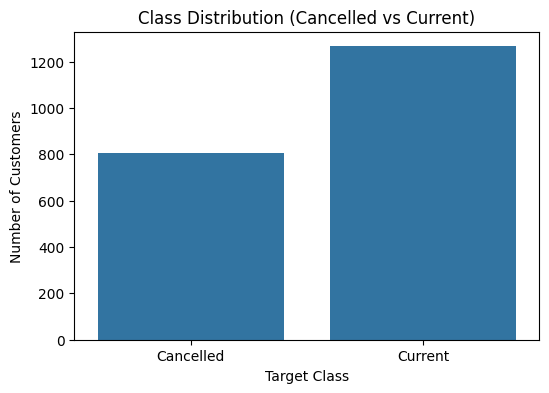

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_class_distribution(data):
    """
    Plots the distribution of the target class ('Cancelled' or 'Current').
    """
    plt.figure(figsize=(6, 4))
    sns.countplot(x='TARGET', data=data)
    plt.title('Class Distribution (Cancelled vs Current)')
    plt.ylabel('Number of Customers')
    plt.xlabel('Target Class')
    plt.show()

# Plot class distribution
plot_class_distribution(data)

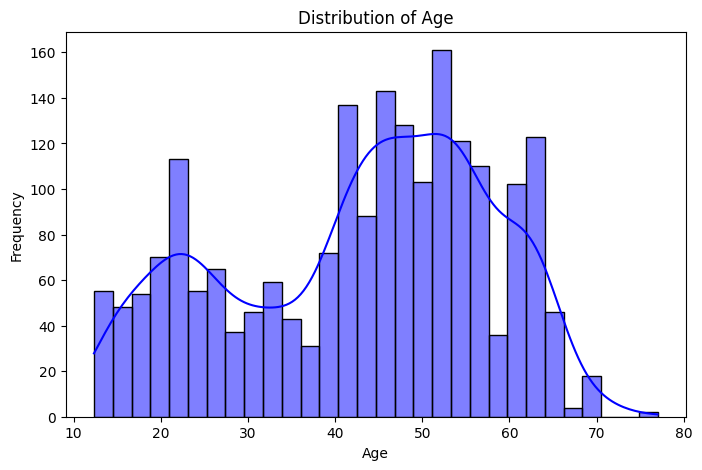

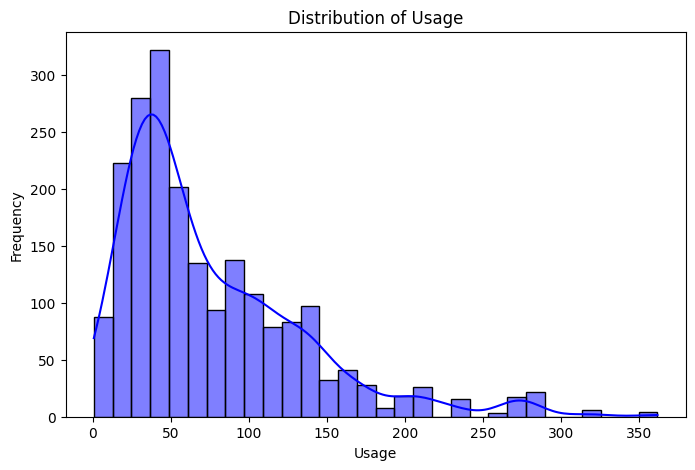

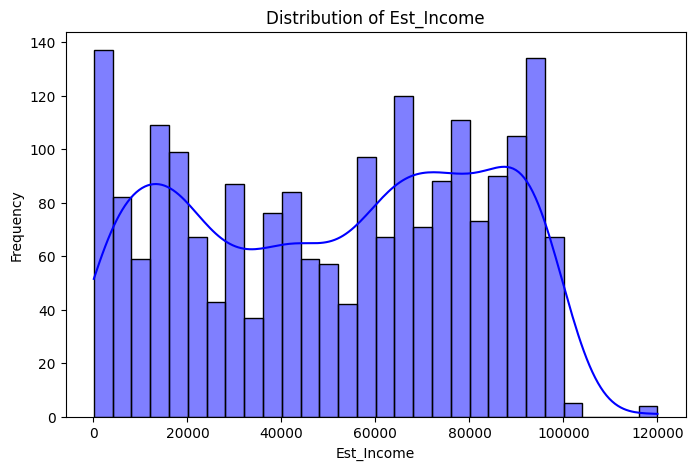

In [ ]:
def plot_numerical_feature_distribution(data, feature):
    """
    Plots the distribution of a numerical feature.
    """
    plt.figure(figsize=(8, 5))
    sns.histplot(data[feature], kde=True, bins=30, color='blue')
    plt.title(f'Distribution of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.show()

# Plot distributions for numerical features
plot_numerical_feature_distribution(data, 'Age')
plot_numerical_feature_distribution(data, 'Usage')
plot_numerical_feature_distribution(data, 'Est_Income')

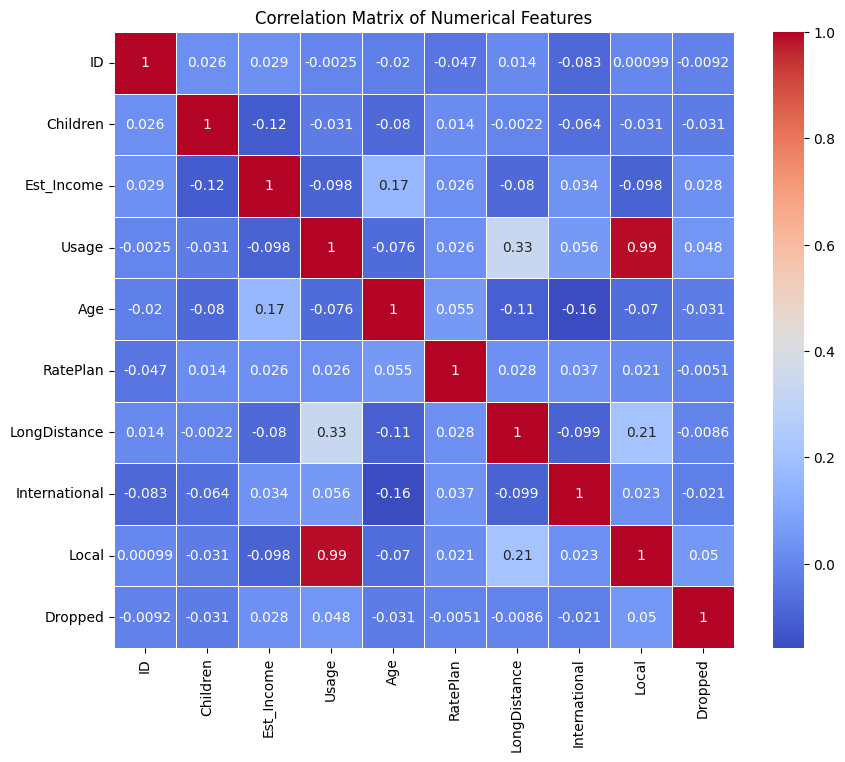

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_correlation_matrix(data):
    """
    Plots a correlation matrix for numerical features.
    """
    # Select only numerical features before calculating correlation
    numerical_data = data.select_dtypes(include=['number'])

    plt.figure(figsize=(10, 8))
    correlation_matrix = numerical_data.corr() # Calculate correlation on numerical data only
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
    plt.title('Correlation Matrix of Numerical Features')
    plt.show()

# Plot correlation matrix
plot_correlation_matrix(data)

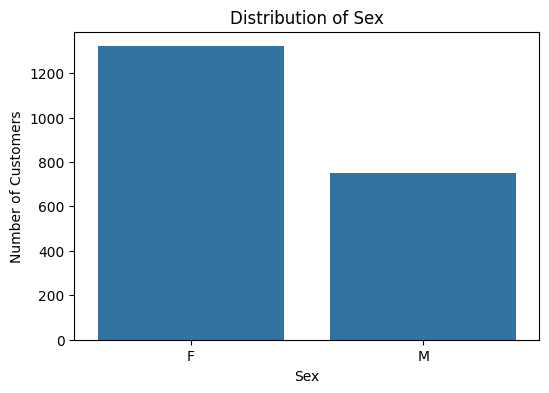

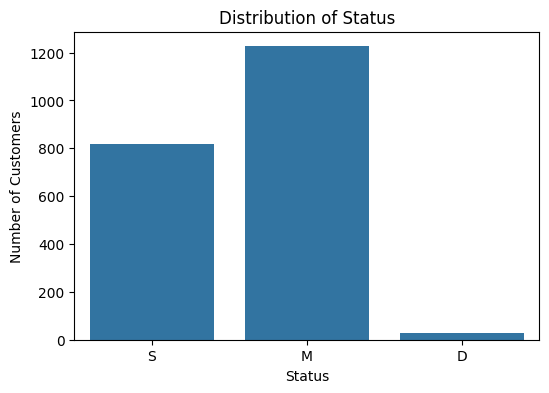

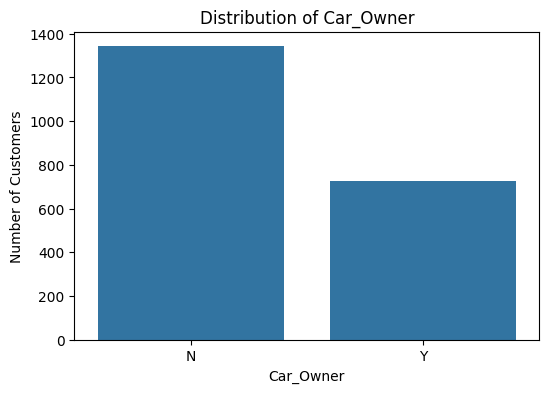

In [ ]:
def plot_categorical_feature_distribution(data, feature):
    """
    Plots the distribution of a categorical feature.
    """
    plt.figure(figsize=(6, 4))
    sns.countplot(x=feature, data=data)
    plt.title(f'Distribution of {feature}')
    plt.ylabel('Number of Customers')
    plt.xlabel(feature)
    plt.show()

# Plot distributions for categorical features
plot_categorical_feature_distribution(data, 'Sex')
plot_categorical_feature_distribution(data, 'Status')
plot_categorical_feature_distribution(data, 'Car_Owner')

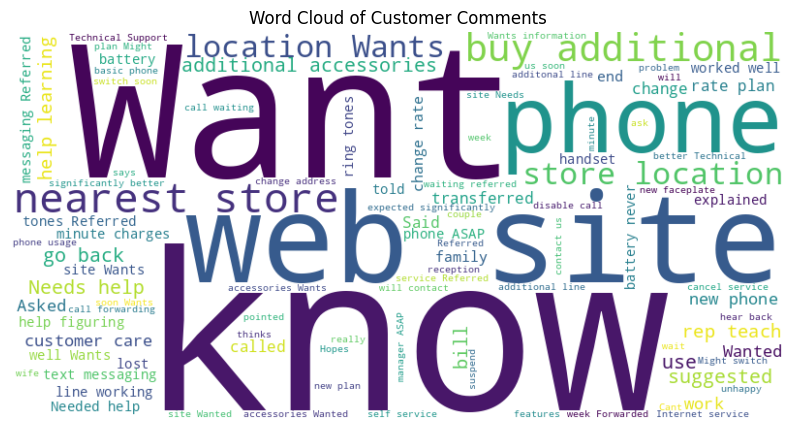

In [ ]:
from wordcloud import WordCloud

def plot_wordcloud(text_data):
    """
    Plots a word cloud for the text data.
    """
    wordcloud = WordCloud(width=800, height=400, background_color='white', max_words=100).generate(" ".join(text_data))

    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('Word Cloud of Customer Comments')
    plt.show()

# Plot word cloud
plot_wordcloud(comments_data['Comments'])  # Replace with your comments column

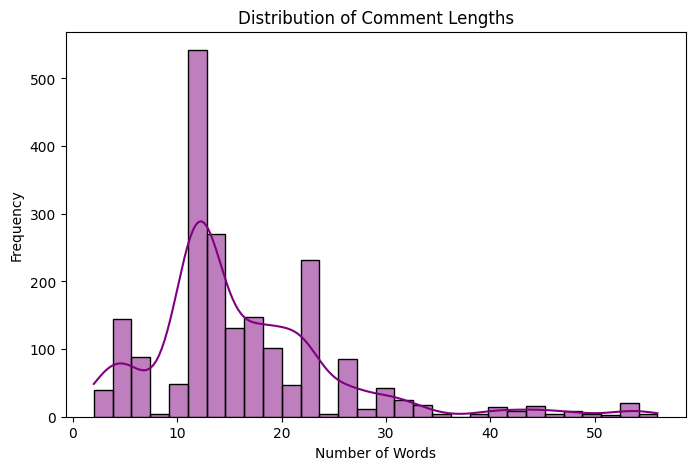

In [ ]:
def plot_comment_length_distribution(text_data):
    """
    Plots the distribution of comment lengths.
    """
    comment_lengths = text_data.apply(lambda x: len(x.split()))

    plt.figure(figsize=(8, 5))
    sns.histplot(comment_lengths, bins=30, kde=True, color='purple')
    plt.title('Distribution of Comment Lengths')
    plt.xlabel('Number of Words')
    plt.ylabel('Frequency')
    plt.show()

# Plot comment length distribution
plot_comment_length_distribution(comments_data['Comments'])

<ipython-input-13-fad713003e52>:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Frequency', y='N-gram', data=ngram_df, palette='Blues_d')


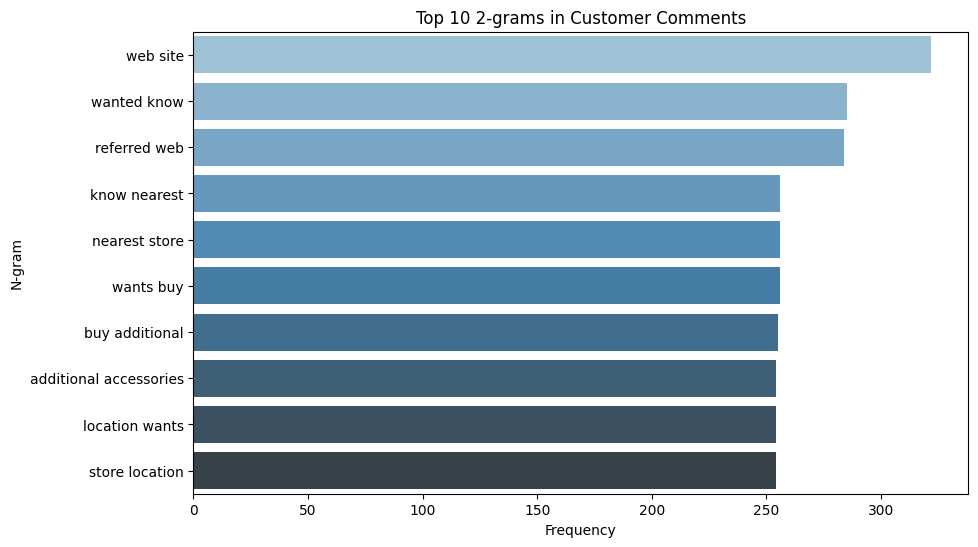

<ipython-input-13-fad713003e52>:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Frequency', y='N-gram', data=ngram_df, palette='Blues_d')


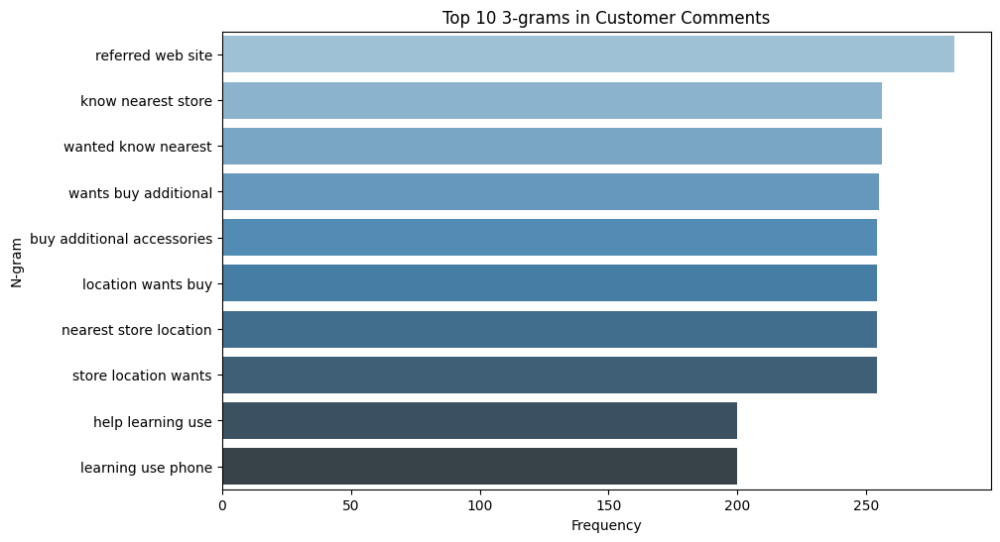

In [ ]:
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer

def plot_top_ngrams(text_data, n=2, num=10):
    """
    Plots the top N-grams (bigrams/trigrams) in the text data.
    """
    # Create N-grams using CountVectorizer
    vectorizer = CountVectorizer(ngram_range=(n, n), stop_words='english')
    ngrams = vectorizer.fit_transform(text_data)
    ngram_counts = Counter(dict(zip(vectorizer.get_feature_names_out(), ngrams.toarray().sum(axis=0))))

    # Get the most common N-grams
    top_ngrams = ngram_counts.most_common(num)

    # Plot the top N-grams
    ngram_df = pd.DataFrame(top_ngrams, columns=['N-gram', 'Frequency'])
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Frequency', y='N-gram', data=ngram_df, palette='Blues_d')
    plt.title(f'Top {num} {n}-grams in Customer Comments')
    plt.xlabel('Frequency')
    plt.ylabel('N-gram')
    plt.show()

# Plot top bigrams (n=2)
plot_top_ngrams(comments_data['Comments'], n=2, num=10)

# Plot top trigrams (n=3)
plot_top_ngrams(comments_data['Comments'], n=3, num=10)

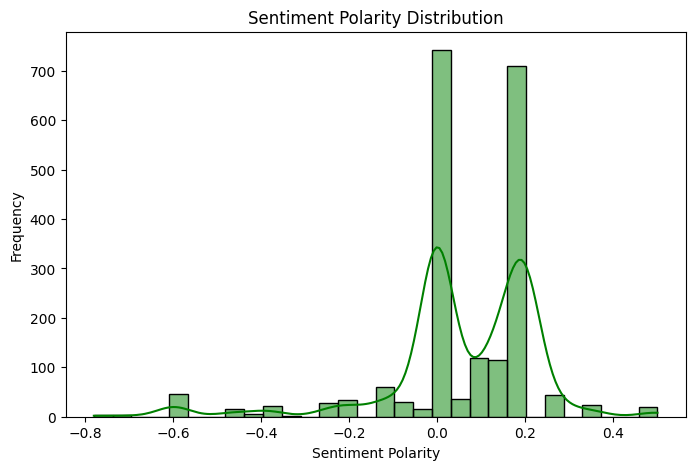

In [ ]:
from textblob import TextBlob

def plot_sentiment_distribution(text_data):
    """
    Plots the distribution of sentiment polarity scores for comments.
    """
    sentiment_scores = text_data.apply(lambda x: TextBlob(x).sentiment.polarity)

    plt.figure(figsize=(8, 5))
    sns.histplot(sentiment_scores, bins=30, kde=True, color='green')
    plt.title('Sentiment Polarity Distribution')
    plt.xlabel('Sentiment Polarity')
    plt.ylabel('Frequency')
    plt.show()

# Plot sentiment distribution
plot_sentiment_distribution(comments_data['Comments'])  # Replace with your comments column

# Data Preprocessing

In [ ]:
# Drop unnecessary columns
data = data.drop(columns=['ID'])

In [ ]:
# Assuming 'data' is your dataset in a DataFrame

# Handle missing values
data['Est_Income'] = pd.to_numeric(data['Est_Income'], errors='coerce')  # Convert to numeric, handling errors as NaN
data['Est_Income'].fillna(data['Est_Income'].mean(), inplace=True)  # Replace missing income with the mean value
data['Comments'].fillna('No comments', inplace=True)  # Replace missing comments with a placeholder
data['RatePlan'].fillna('No Plan', inplace=True)  # Assuming missing rate plans are replaced with a placeholder

# Convert categorical columns to numeric using LabelEncoder
encoder = LabelEncoder()
categorical_cols = ['Sex', 'Status', 'Car_Owner', 'Usage', 'Paymethod', 'LocalBilltype', 'LongDistanceBilltype', 'TARGET']

for col in categorical_cols:
    data[col] = encoder.fit_transform(data[col])  # Encode categorical columns as numeric values

<ipython-input-16-d2737c2b4797>:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data['Est_Income'].fillna(data['Est_Income'].mean(), inplace=True)  # Replace missing income with the mean value
<ipython-input-16-d2737c2b4797>:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For exa

# Text Preprocessing


In [ ]:
# Text preprocessing function
import re
def clean_text(text):
    text = text.lower()
    text = re.sub(r'\b\w{1,2}\b', '', text)  # Remove short words
    text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
    text = re.sub(r'\s+', ' ', text)  # Remove extra whitespace
    return text

In [ ]:
# Apply text cleaning
data['clean_comments'] = data['Comments'].apply(clean_text)


In [ ]:
data.head()

,Sex,Status,Children,Est_Income,Car_Owner,Usage,Age,RatePlan,LongDistance,International,Local,Dropped,Paymethod,LocalBilltype,LongDistanceBilltype,TARGET,Comments,clean_comments
0,0,2,1,38000.00,0,318,24.393333,3,23.56,0.0,206.08,0,1,0,0,0,Asked about how to change his ring tones. Refe...,asked about how change his ring tones referred...
1,1,1,2,29616.00,0,202,49.426667,2,29.78,0.0,45.50,0,2,1,1,1,Needs help learning how to use the phone. I su...,needs help learning how use the phone suggeste...
2,1,1,0,19732.80,0,134,50.673333,3,24.81,0.0,22.44,0,1,1,1,1,Needs help learning how to use the phone. I su...,needs help learning how use the phone suggeste...
3,1,2,2,96.33,0,169,56.473333,1,26.13,0.0,32.88,1,1,0,1,1,Needs help learning how to use the phone. I su...,needs help learning how use the phone suggeste...
4,0,1,2,52004.80,0,62,25.140000,1,5.03,0.0,23.11,0,2,0,0,0,Needs help learning how to use the phone. I su...,needs help learning how use the phone suggeste...


# Split Features and Target


In [ ]:
# Split features and targ
X_structured = data.drop([ 'TARGET', 'Comments', 'clean_comments'], axis=1)  # Structured data
X_text = data['clean_comments']  # Text data
y = data['TARGET']

In [ ]:
X_structured.head()

,Sex,Status,Children,Est_Income,Car_Owner,Usage,Age,RatePlan,LongDistance,International,Local,Dropped,Paymethod,LocalBilltype,LongDistanceBilltype
0,0,2,1,38000.00,0,318,24.393333,3,23.56,0.0,206.08,0,1,0,0
1,1,1,2,29616.00,0,202,49.426667,2,29.78,0.0,45.50,0,2,1,1
2,1,1,0,19732.80,0,134,50.673333,3,24.81,0.0,22.44,0,1,1,1
3,1,2,2,96.33,0,169,56.473333,1,26.13,0.0,32.88,1,1,0,1
4,0,1,2,52004.80,0,62,25.140000,1,5.03,0.0,23.11,0,2,0,0


In [ ]:
# Identify columns with string or object dtype
string_cols = X_structured.select_dtypes(include=['object', 'string']).columns
print(string_cols)

Index([], dtype='object')


# NLP: Vectorize the Feedback Column


In [ ]:
# NLP: Vectorize the 'Feedback' column using TF-IDF
vectorizer = TfidfVectorizer(max_features=500)
feedback_tfidf = vectorizer.fit_transform(X_text).toarray()


# Normalize Structured Data


In [ ]:
from sklearn.preprocessing import StandardScaler
# Normalize the structured data
scaler = StandardScaler()
X_structured = scaler.fit_transform(X_structured)

# Concatenate TF-IDF Features with Structured Features


In [ ]:
# Concatenate TF-IDF features with other structured features
X = np.hstack((X_structured, feedback_tfidf))
y = data['TARGET']

# Handle Class Imbalance using SMOTE


In [ ]:
print("NO Churn :",len(y[y==0]))
print("Churn :",len(y[y==1]))

NO Churn : 804
Churn : 1266


In [ ]:
# Handle class imbalance using SMOTE
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)


In [ ]:
#after Applying SMOTE
print("NO Churn :",len(y_resampled[y_resampled==0]))
print("Churn :",len(y_resampled[y_resampled==1]))

NO Churn : 1266
Churn : 1266


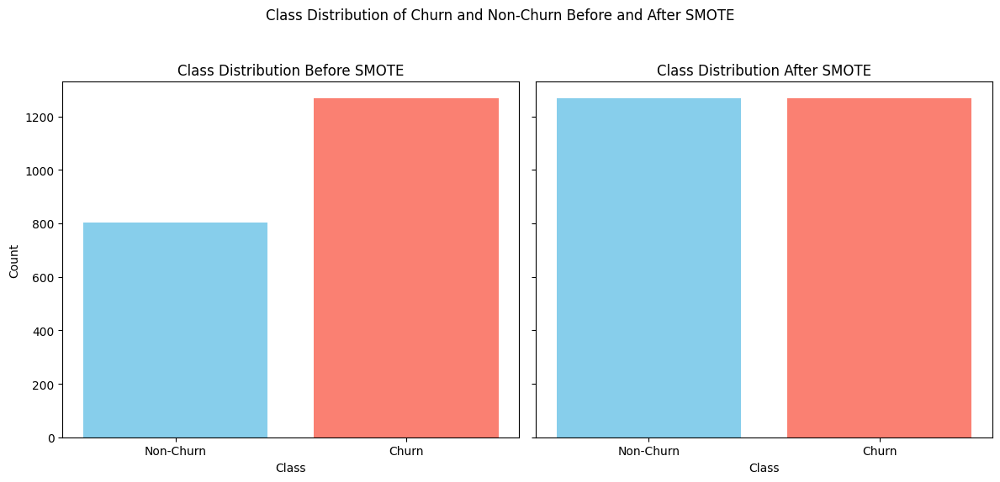

In [ ]:
import matplotlib.pyplot as plt

# Define class categories and counts
categories = ['Non-Churn', 'Churn']
before_smote_counts = [len(y[y==0]), len(y[y==1])]
after_smote_counts = [len(y_resampled[y_resampled==0]), len(y_resampled[y_resampled==1])]

# Create a figure with two subplots
fig, ax = plt.subplots(1, 2, figsize=(12, 6), sharey=True)

# Plot for "Before SMOTE"
ax[0].bar(categories, before_smote_counts, color=['skyblue', 'salmon'])
ax[0].set_title('Class Distribution Before SMOTE')
ax[0].set_xlabel('Class')
ax[0].set_ylabel('Count')

# Plot for "After SMOTE"
ax[1].bar(categories, after_smote_counts, color=['skyblue', 'salmon'])
ax[1].set_title('Class Distribution After SMOTE')
ax[1].set_xlabel('Class')

# Adjust layout and display the plot
plt.suptitle('Class Distribution of Churn and Non-Churn Before and After SMOTE')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


# Split the Data


In [ ]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)


In [ ]:
# Import libraries
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:

# Convert to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train.values, dtype=torch.long)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

# MULTI INPUT NEURAL NETWORK

In [ ]:
import torch.optim as optim
# Define multi-input neural network model
class MultiInputNN(nn.Module):
    def __init__(self, input_dim_structured, input_dim_text, hidden_dim, output_dim):
        super(MultiInputNN, self).__init__()

        # Structured data branch
        self.fc_structured = nn.Sequential(
            nn.Linear(input_dim_structured, hidden_dim),
            nn.ReLU(),
            nn.Dropout(0.3)
        )

        # Text data branch
        self.fc_text = nn.Sequential(
            nn.Linear(input_dim_text, hidden_dim),
            nn.ReLU(),
            nn.Dropout(0.3)
        )

        # Merge both branches
        self.fc_combined = nn.Sequential(
            nn.Linear(2 * hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, structured_input, text_input):
        # Process structured input
        structured_out = self.fc_structured(structured_input)

        # Process text input
        text_out = self.fc_text(text_input)

        # Combine both outputs
        combined_out = torch.cat((structured_out, text_out), dim=1)

        # Final output
        output = self.fc_combined(combined_out)
        return output

# Model initialization
input_dim_structured = X_train_tensor.shape[1] - feedback_tfidf.shape[1]
input_dim_text = feedback_tfidf.shape[1]
hidden_dim = 128
output_dim = 2  # For binary classification (Churn or Not Churn)

model = MultiInputNN(input_dim_structured, input_dim_text, hidden_dim, output_dim)

# Loss and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Train the model
num_epochs = 10
batch_size = 64
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Initialize accuracy variables for tracking
train_accuracies = []
test_accuracies = []

for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    correct = 0
    total = 0
    for batch_X, batch_y in train_loader:
        structured_input = batch_X[:, :input_dim_structured]
        text_input = batch_X[:, input_dim_structured:]

        # Forward pass
        output = model(structured_input, text_input)

        # Compute loss
        loss = criterion(output, batch_y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        # Training accuracy calculation
        _, predicted = torch.max(output, 1)
        correct += (predicted == batch_y).sum().item()
        total += batch_y.size(0)

    avg_loss = total_loss / len(train_loader)
    train_accuracy = (correct / total) * 100
    train_accuracies.append(train_accuracy)

    # Testing phase after every epoch
    model.eval()
    with torch.no_grad():
        test_output = model(X_test_tensor[:, :input_dim_structured], X_test_tensor[:, input_dim_structured:])
        _, test_pred = torch.max(test_output, 1)
        test_accuracy = ((test_pred == y_test_tensor).sum().item() / y_test_tensor.size(0))*100
        test_accuracies.append(test_accuracy)

    # Print the loss and accuracy for the current epoch
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {avg_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Test Accuracy: {test_accuracy:.2f}%")

# After training, display final training and testing accuracy
print("\nFinal Training Accuracy:", train_accuracies[-1])
print("Final Test Accuracy:", test_accuracies[-1])
# Get classification report and confusion matrix for the test set

Epoch [1/10], Loss: 0.6296, Train Accuracy: 66.32%, Test Accuracy: 78.70%
Epoch [2/10], Loss: 0.4636, Train Accuracy: 80.99%, Test Accuracy: 84.62%
Epoch [3/10], Loss: 0.3839, Train Accuracy: 85.28%, Test Accuracy: 88.56%
Epoch [4/10], Loss: 0.3455, Train Accuracy: 86.57%, Test Accuracy: 90.34%
Epoch [5/10], Loss: 0.3310, Train Accuracy: 87.70%, Test Accuracy: 91.12%
Epoch [6/10], Loss: 0.3129, Train Accuracy: 88.15%, Test Accuracy: 89.74%
Epoch [7/10], Loss: 0.2950, Train Accuracy: 89.38%, Test Accuracy: 89.55%
Epoch [8/10], Loss: 0.2951, Train Accuracy: 88.89%, Test Accuracy: 90.14%
Epoch [9/10], Loss: 0.2805, Train Accuracy: 89.78%, Test Accuracy: 90.73%
Epoch [10/10], Loss: 0.2596, Train Accuracy: 90.17%, Test Accuracy: 90.93%

Final Training Accuracy: 90.17283950617283
Final Test Accuracy: 90.92702169625247


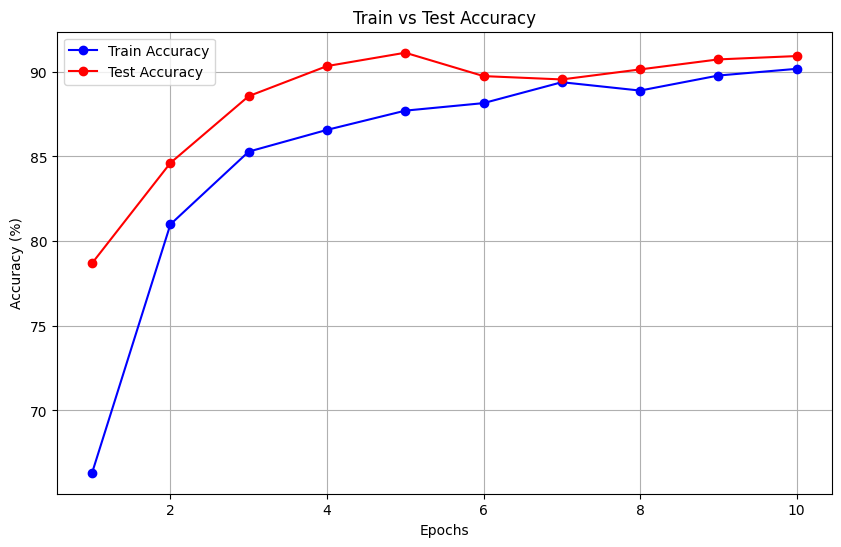

In [ ]:
# Plotting training and testing accuracy
plt.figure(figsize=(10, 6))
plt.plot(range(1, num_epochs + 1), train_accuracies, label='Train Accuracy', color='blue', marker='o')
plt.plot(range(1, num_epochs + 1), test_accuracies, label='Test Accuracy', color='red', marker='o')
plt.title('Train vs Test Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Classification report
print("\nClassification Report:")
print(classification_report(y_test_tensor.cpu(), test_pred.cpu(), target_names=['Not Churn', 'Churn']))


Classification Report:
              precision    recall  f1-score   support

   Not Churn       0.91      0.90      0.91       246
       Churn       0.91      0.92      0.91       261

    accuracy                           0.91       507
   macro avg       0.91      0.91      0.91       507
weighted avg       0.91      0.91      0.91       507




Confusion Matrix:
[[222  24]
 [ 22 239]]


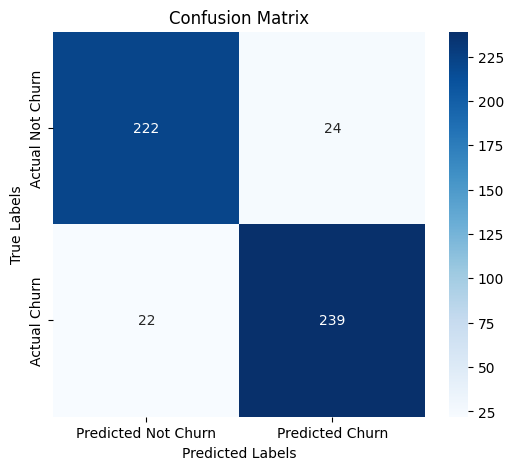

In [ ]:
 # Confusion Matrix
cm = confusion_matrix(y_test_tensor.cpu(), test_pred.cpu())
print("\nConfusion Matrix:")
print(cm)

    # Plotting the confusion matrix
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=['Predicted Not Churn', 'Predicted Churn'], yticklabels=['Actual Not Churn', 'Actual Churn'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from torchsummary import summary

# Initialize the model as before
input_dim_structured = X_train_tensor.shape[1] - feedback_tfidf.shape[1]
input_dim_text = feedback_tfidf.shape[1]
hidden_dim = 128
output_dim = 2  # For binary classification (Churn or Not Churn)

model = MultiInputNN(input_dim_structured, input_dim_text, hidden_dim, output_dim)

# Print the model summary
summary(model, [(input_dim_structured,), (input_dim_text,)])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                  [-1, 128]           2,048
              ReLU-2                  [-1, 128]               0
           Dropout-3                  [-1, 128]               0
            Linear-4                  [-1, 128]          64,128
              ReLU-5                  [-1, 128]               0
           Dropout-6                  [-1, 128]               0
            Linear-7                  [-1, 128]          32,896
              ReLU-8                  [-1, 128]               0
           Dropout-9                  [-1, 128]               0
           Linear-10                    [-1, 2]             258
Total params: 99,330
Trainable params: 99,330
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.03
Forward/backward pass size (MB): 0.01
Params size (MB): 0.38
Estimated Tot

In [ ]:
# Function to preprocess a single sample
def preprocess_single_sample(sample, vectorizer, scaler, encoder):
    # Convert sample to DataFrame
    sample_df = pd.DataFrame([sample])

    # Clean text data
    sample_df['clean_comments'] = sample_df['Comments'].apply(clean_text)
    sample_text = sample_df['clean_comments']

    # Vectorize text data
    sample_text_tfidf = vectorizer.transform(sample_text).toarray()

    # Drop unnecessary columns
    sample_structured = sample_df.drop(['Comments', 'clean_comments'], axis=1)

    # Normalize structured data
    sample_structured = scaler.transform(sample_structured)

    # Combine structured and text data
    sample_combined = np.hstack((sample_structured, sample_text_tfidf))

    return torch.tensor(sample_combined, dtype=torch.float32)

# Example single sample (similar to your dataset)
single_sample = {
    'Sex': 0,
    'Status': 1,
    'Children': 0,
    'Est_Income': 45000.00,
    'Car_Owner':0,
    'Usage': 50.00,
    'Age': 35,
    'RatePlan': '1',
    'LongDistance': 15.00,
    'International': 0.00,
    'Local': 35.00,
    'Dropped': 0,
    'Paymethod': 1,
    'LocalBilltype': 0,
    'LongDistanceBilltype': 1,
    'Comments': 'Wanted to know about new plans available.'
}

# Preprocess the single sample
preprocessed_sample = preprocess_single_sample(single_sample, vectorizer, scaler, encoder)

# Separate structured and text data
structured_input = preprocessed_sample[:, :input_dim_structured]
text_input = preprocessed_sample[:, input_dim_structured:]

# Test the model on the single sample
model.eval()
with torch.no_grad():
    prediction = model(structured_input, text_input)
    _, predicted_label = torch.max(prediction, 1)

# Decode the predicted label
predicted_target = encoder.inverse_transform(predicted_label.numpy())
print(f"Predicted Target MULTI INPUT NN: {predicted_target[0]}")

Predicted Target MULTI INPUT NN: Current


# DNN

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout

In [ ]:
# Define DNN model
dnn_model = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(32, activation='relu'),
    Dense(1, activation='sigmoid')  # Output layer for binary classification
])


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
# Compile the model
dnn_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
# Train the model
hist=dnn_model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)


Epoch 1/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.5670 - loss: 0.6784 - val_accuracy: 0.7852 - val_loss: 0.5435
Epoch 2/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8038 - loss: 0.4739 - val_accuracy: 0.8173 - val_loss: 0.4253
Epoch 3/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8519 - loss: 0.3699 - val_accuracy: 0.8840 - val_loss: 0.3521
Epoch 4/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8850 - loss: 0.3191 - val_accuracy: 0.8889 - val_loss: 0.3267
Epoch 5/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9068 - loss: 0.2813 - val_accuracy: 0.8914 - val_loss: 0.3188
Epoch 6/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9178 - loss: 0.2568 - val_accuracy: 0.8938 - val_loss: 0.3056
Epoch 7/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9159 - loss: 0.2340 - val_accuracy: 0.8914 - val_loss: 0.3008
Epoch 8/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9177 - loss: 0.2396 - val_accuracy: 0.8988 - val_loss:

In [ ]:
# Evaluate the model
dnn_loss, dnn_accuracy = dnn_model.evaluate(X_test, y_test)
print(f"DNN Accuracy: {dnn_accuracy * 100:.2f}%")


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9100 - loss: 0.2805 
DNN Accuracy: 90.53%


In [ ]:
from sklearn.metrics import classification_report

# Get predictions on the test set
y_pred = dnn_model.predict(X_test)

# Convert predicted probabilities to class labels (assuming binary classification)
y_pred_classes = [1 if p > 0.5 else 0 for p in y_pred]

# Generate the classification report
report = classification_report(y_test, y_pred_classes)
print(report)

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
              precision    recall  f1-score   support

           0       0.90      0.91      0.90       246
           1       0.91      0.90      0.91       261

    accuracy                           0.91       507
   macro avg       0.91      0.91      0.91       507
weighted avg       0.91      0.91      0.91       507



In [ ]:
# Print the summary of the DNN model
dnn_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 128)                 │          66,048 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 229,253 (895.52 KB)

 Trainable params: 76,417 (298.50 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 152,836 (597.02 KB)

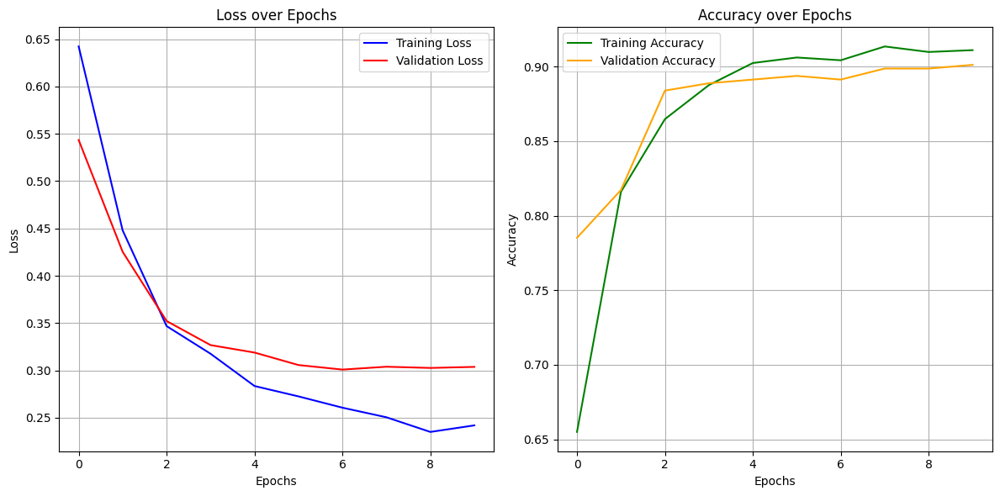

In [ ]:

# Plotting loss and accuracy graphs
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Plot Loss
ax1.plot(hist.history['loss'], label="Training Loss", color='blue')
ax1.plot(hist.history['val_loss'], label="Validation Loss", color='red')
ax1.set_title("Loss over Epochs")
ax1.set_xlabel("Epochs")
ax1.set_ylabel("Loss")
ax1.legend()
ax1.grid(True)


# Plot Accuracy
ax2.plot(hist.history['accuracy'], label="Training Accuracy", color='green')
ax2.plot(hist.history['val_accuracy'], label="Validation Accuracy", color='orange')
ax2.set_title("Accuracy over Epochs")
ax2.set_xlabel("Epochs")
ax2.set_ylabel("Accuracy")
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()


16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


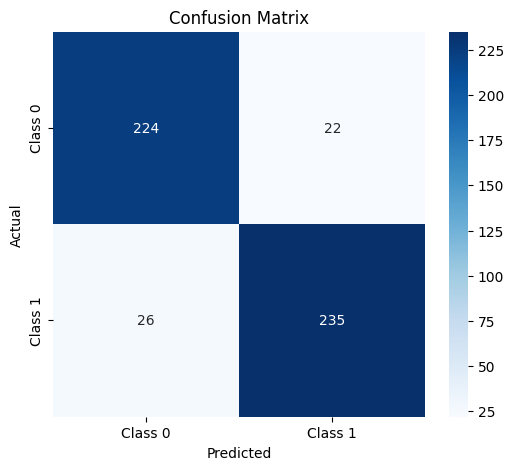

In [ ]:
# Predictions on the test set
y_pred = (dnn_model.predict(X_test) > 0.5).astype("int32")


# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)

# Plot Confusion Matrix using heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Class 0", "Class 1"], yticklabels=["Class 0", "Class 1"])
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

In [ ]:
# Function to preprocess a single sample
def preprocess_single_sample(sample, vectorizer, scaler, encoder):
    # Convert sample to DataFrame
    sample_df = pd.DataFrame([sample])

    # Clean text data
    sample_df['clean_comments'] = sample_df['Comments'].apply(clean_text)
    sample_text = sample_df['clean_comments']

    # Vectorize text data
    sample_text_tfidf = vectorizer.transform(sample_text).toarray()

    # Drop unnecessary columns
    sample_structured = sample_df.drop(['Comments', 'clean_comments'], axis=1)

    # Normalize structured data
    sample_structured = scaler.transform(sample_structured)

    # Combine structured and text data
    sample_combined = np.hstack((sample_structured, sample_text_tfidf))

    return torch.tensor(sample_combined, dtype=torch.float32)

# Example single sample (similar to your dataset)
single_sample = {
    'Sex': 0,
    'Status': 1,
    'Children': 0,
    'Est_Income': 45000.00,
    'Car_Owner':0,
    'Usage': 50.00,
    'Age': 35,
    'RatePlan': '1',
    'LongDistance': 15.00,
    'International': 0.00,
    'Local': 35.00,
    'Dropped': 0,
    'Paymethod': 1,
    'LocalBilltype': 0,
    'LongDistanceBilltype': 1,
    'Comments': 'Wanted to know about new plans available.'
}

# Preprocess the single sample
preprocessed_sample = preprocess_single_sample(single_sample, vectorizer, scaler, encoder)

# Separate structured and text data
structured_input = preprocessed_sample[:, :input_dim_structured]
text_input = preprocessed_sample[:, input_dim_structured:]

# Test the model on the single sample
model.eval()
with torch.no_grad():
    prediction = model(structured_input, text_input)
    _, predicted_label = torch.max(prediction, 1)

# Decode the predicted label
predicted_target = encoder.inverse_transform(predicted_label.numpy())
print(f"Predicted Target DNN: {predicted_target[0]}")

Predicted Target DNN: Current


# Seq2Seq Transformer Model

In [ ]:
# Hyperparameters
input_dim = X_train.shape[1]
hidden_dim = 64
output_dim = 2
nhead = 4
num_layers = 2
batch_size = 32
num_epochs = 10

In [ ]:
# Define the Seq2Seq Transformer model
class Seq2SeqTransformer(nn.Module):
    def __init__(self, input_dim, hidden_dim, nhead, num_layers, output_dim):
        super(Seq2SeqTransformer, self).__init__()
        self.encoder_layer = nn.TransformerEncoderLayer(d_model=hidden_dim, nhead=nhead, batch_first=True)
        self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(hidden_dim, output_dim)
        self.input_fc = nn.Linear(input_dim, hidden_dim)  # Project input to hidden_dim size

    def forward(self, x):
        x = self.input_fc(x)         # Project input to hidden_dim size
        x = x.unsqueeze(1)           # Add sequence length dimension as 1 (batch, seq_len, feature_dim)
        x = self.encoder(x)
        x = x.mean(dim=1)            # Global average pooling over the sequence length
        x = self.fc(x)
        return x


In [ ]:
# Initialize the model, optimizer, and loss function
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = Seq2SeqTransformer(input_dim, hidden_dim, nhead, num_layers, output_dim).to(device)
optimizer = Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

# Create DataLoader
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Lists to store loss and accuracy values
train_losses = []
train_accuracies = []
val_losses=[]
val_accuracies=[]

In [ ]:
# Training loop
model.train()
for epoch in range(num_epochs):
    total_loss = 0
    correct = 0
    total = 0
    for batch_X, batch_y in train_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        optimizer.zero_grad()
        output = model(batch_X)
        loss = criterion(output, batch_y)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

        # Accuracy calculation
        _, predicted = torch.max(output, 1)
        correct += (predicted == batch_y).sum().item()
        total += batch_y.size(0)

    avg_loss = total_loss / len(train_loader)
    accuracy = correct / total * 100
    train_losses.append(avg_loss)
    train_accuracies.append(accuracy)

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")

Epoch 1/10, Loss: 0.4709, Accuracy: 78.96%
Epoch 2/10, Loss: 0.3277, Accuracy: 88.05%
Epoch 3/10, Loss: 0.2930, Accuracy: 89.53%
Epoch 4/10, Loss: 0.2879, Accuracy: 89.73%
Epoch 5/10, Loss: 0.2499, Accuracy: 90.96%
Epoch 6/10, Loss: 0.2574, Accuracy: 90.77%
Epoch 7/10, Loss: 0.2454, Accuracy: 90.96%
Epoch 8/10, Loss: 0.2549, Accuracy: 91.31%
Epoch 9/10, Loss: 0.2423, Accuracy: 91.06%
Epoch 10/10, Loss: 0.2304, Accuracy: 91.41%


In [ ]:
# Evaluation
model.eval()
with torch.no_grad():
    # Predictions for training and testing data
    y_pred_train = model(X_train_tensor.to(device)).argmax(dim=1).cpu()
    y_pred_test = model(X_test_tensor.to(device)).argmax(dim=1).cpu()
    y_train_actual = y_train_tensor.cpu()
    y_test_actual = y_test_tensor.cpu()

    # Train and test accuracy
    train_accuracy = accuracy_score(y_train_actual, y_pred_train)
    test_accuracy = accuracy_score(y_test_actual, y_pred_test)

    print(f"Train Accuracy: {train_accuracy:.4f}")
    print(f"Test Accuracy: {test_accuracy:.4f}")
    print("\nClassification Report on Test Data:\n", classification_report(y_test_actual, y_pred_test))

    # Confusion Matrix
    cm = confusion_matrix(y_test_actual, y_pred_test)

Train Accuracy: 0.9304
Test Accuracy: 0.9112

Classification Report on Test Data:
               precision    recall  f1-score   support

           0       0.89      0.94      0.91       246
           1       0.94      0.89      0.91       261

    accuracy                           0.91       507
   macro avg       0.91      0.91      0.91       507
weighted avg       0.91      0.91      0.91       507



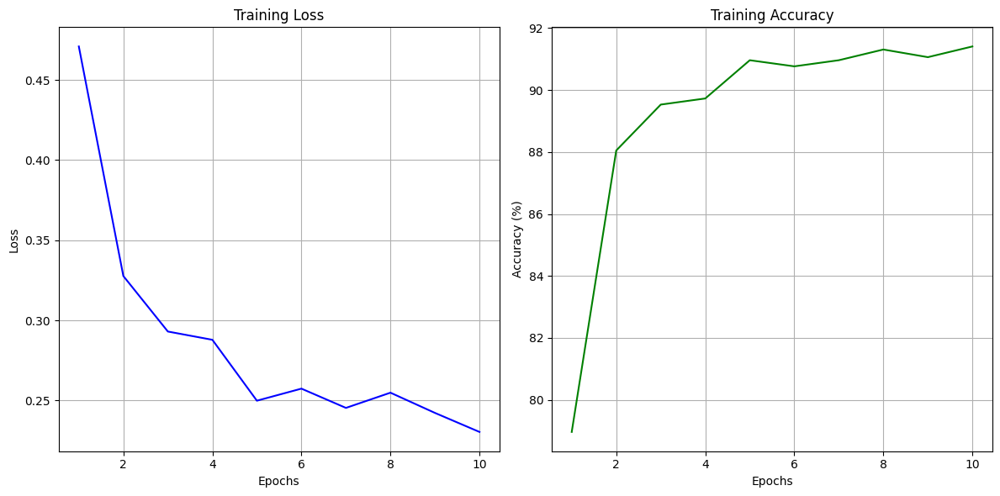

In [ ]:
# Plotting Loss and Accuracy graphs
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Plot Loss
ax1.plot(range(1, num_epochs + 1), train_losses, label="Loss", color="blue")
ax1.set_title("Training Loss")
ax1.set_xlabel("Epochs")
ax1.set_ylabel("Loss")
ax1.grid(True)

# Plot Accuracy
ax2.plot(range(1, num_epochs + 1), train_accuracies, label="Accuracy", color="green")
ax2.set_title("Training Accuracy")
ax2.set_xlabel("Epochs")
ax2.set_ylabel("Accuracy (%)")
ax2.grid(True)

plt.tight_layout()
plt.show()

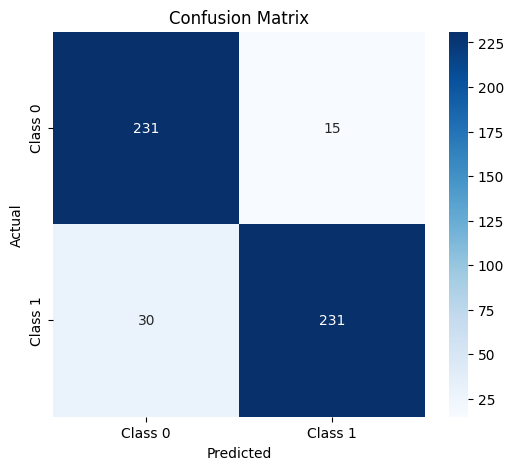

In [ ]:
# Plot Confusion Matrix
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Class 0", "Class 1"], yticklabels=["Class 0", "Class 1"])
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

In [ ]:
print(model)

Seq2SeqTransformer(
  (encoder_layer): TransformerEncoderLayer(
    (self_attn): MultiheadAttention(
      (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
    )
    (linear1): Linear(in_features=64, out_features=2048, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
    (linear2): Linear(in_features=2048, out_features=64, bias=True)
    (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
    (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
    (dropout1): Dropout(p=0.1, inplace=False)
    (dropout2): Dropout(p=0.1, inplace=False)
  )
  (encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-1): 2 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=2048, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
        (linear2): 

In [ ]:
# Function to preprocess a single sample
def preprocess_single_sample(sample, vectorizer, scaler, encoder):
    # Convert sample to DataFrame
    sample_df = pd.DataFrame([sample])

    # Clean text data
    sample_df['clean_comments'] = sample_df['Comments'].apply(clean_text)
    sample_text = sample_df['clean_comments']

    # Vectorize text data
    sample_text_tfidf = vectorizer.transform(sample_text).toarray()

    # Drop unnecessary columns
    sample_structured = sample_df.drop(['Comments', 'clean_comments'], axis=1)

    # Normalize structured data
    sample_structured = scaler.transform(sample_structured)

    # Combine structured and text data
    sample_combined = np.hstack((sample_structured, sample_text_tfidf))

    return torch.tensor(sample_combined, dtype=torch.float32)

# Example single sample (similar to your dataset)
single_sample = {
    'Sex': 0,
    'Status': 1,
    'Children': 0,
    'Est_Income': 45000.00,
    'Car_Owner':0,
    'Usage': 50.00,
    'Age': 35,
    'RatePlan': '1',
    'LongDistance': 15.00,
    'International': 0.00,
    'Local': 35.00,
    'Dropped': 0,
    'Paymethod': 1,
    'LocalBilltype': 0,
    'LongDistanceBilltype': 1,
    'Comments': 'Wanted to know about new plans available.'
}

# Preprocess the single sample
preprocessed_sample = preprocess_single_sample(single_sample, vectorizer, scaler, encoder)

model.eval()
with torch.no_grad():
    # Predictions for training and testing data
    y_pred_train = model(preprocessed_sample.to(device)).argmax(dim=1).cpu()
    y_pred_classes = ['Current' if p == 1 else 'Cancelled' for p in y_pred_train]
    print('SEQ2SEQ PREDICTION')
    print(y_pred_classes)

SEQ2SEQ PREDICTION
['Current']


# HYBRID CNN2SEQTRANSFORMER

In [ ]:
import torch
import torch.nn as nn
from torch.optim import Adam
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from torch.utils.data import DataLoader, TensorDataset
from torchsummary import summary

class HybridCNNSeq2SeqTransformer(nn.Module):
    def __init__(self, input_dim, hidden_dim, nhead, num_layers, output_dim):
        super(HybridCNNSeq2SeqTransformer, self).__init__()

        # CNN Layer
        self.cnn = nn.Conv1d(in_channels=input_dim, out_channels=hidden_dim, kernel_size=3, stride=1, padding=1)

        # Transformer Encoder Layer
        self.encoder_layer = nn.TransformerEncoderLayer(d_model=hidden_dim, nhead=nhead, batch_first=True)
        self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=num_layers)

        # Fully connected layer to output
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Ensure x has shape (batch_size, input_dim, seq_len) for CNN
        # If input shape is (batch_size, seq_len, input_dim), permute it to (batch_size, input_dim, seq_len)
        if x.dim() == 2:
            x = x.unsqueeze(2)  # Add the sequence length dimension as 1: (batch_size, input_dim, 1)

        # Pass through CNN
        x = self.cnn(x)  # Output shape: (batch_size, hidden_dim, seq_len)

        # Remove the sequence dimension: (batch_size, hidden_dim, seq_len)
        x = x.permute(0, 2, 1)  # (batch_size, seq_len, hidden_dim)

        # Pass through the Transformer Encoder
        x = self.encoder(x)  # Output shape: (batch_size, seq_len, hidden_dim)

        # Global average pooling
        x = x.mean(dim=1)  # Shape: (batch_size, hidden_dim)

        # Fully connected layer
        x = self.fc(x)  # Shape: (batch_size, output_dim)

        return x

# Training setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Assuming X_train_tensor and y_train_tensor are your train data and labels
# Create DataLoader for batching
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# Model hyperparameters
input_dim = X_train.shape[1]  # Number of input features
hidden_dim = 64
output_dim = 2  # Binary classification
nhead = 4
num_layers = 2
num_epochs = 10

# Initialize the model, optimizer, and loss function
model = HybridCNNSeq2SeqTransformer(input_dim, hidden_dim, nhead, num_layers, output_dim).to(device)
optimizer = Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

'''# Lists to store loss and accuracy values
train_losses = []
train_accuracies = []

# Training loop
model.train()
for epoch in range(num_epochs):
    total_loss = 0
    correct = 0
    total = 0
    for batch_X, batch_y in train_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)

        optimizer.zero_grad()
        output = model(batch_X)

        loss = criterion(output, batch_y)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        # Accuracy calculation
        _, predicted = torch.max(output, 1)
        correct += (predicted == batch_y).sum().item()
        total += batch_y.size(0)

    avg_loss = total_loss / len(train_loader)
    accuracy = correct / total * 100
    train_losses.append(avg_loss)
    train_accuracies.append(accuracy)

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")

# Evaluation
model.eval()
with torch.no_grad():
    # Predictions for training and testing data
    y_pred_train = model(X_train_tensor.to(device)).argmax(dim=1).cpu()
    y_pred_test = model(X_test_tensor.to(device)).argmax(dim=1).cpu()
    y_train_actual = y_train_tensor.cpu()
    y_test_actual = y_test_tensor.cpu()

    # Train and test accuracy
    train_accuracy = accuracy_score(y_train_actual, y_pred_train)
    test_accuracy = accuracy_score(y_test_actual, y_pred_test)

    print(f"Train Accuracy: {train_accuracy:.4f}")
    print(f"Test Accuracy: {test_accuracy:.4f}")
    print("\nClassification Report on Test Data:\n", classification_report(y_test_actual, y_pred_test))

    # Confusion Matrix
    cm = confusion_matrix(y_test_actual, y_pred_test)
     # Plotting the confusion matrix
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=['Predicted Negative', 'Predicted Positive'], yticklabels=['Actual Negative', 'Actual Positive'])
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.show()'''

'# Lists to store loss and accuracy values\ntrain_losses = []\ntrain_accuracies = []\n\n# Training loop\nmodel.train()\nfor epoch in range(num_epochs):\n    total_loss = 0\n    correct = 0\n    total = 0\n    for batch_X, batch_y in train_loader:\n        batch_X, batch_y = batch_X.to(device), batch_y.to(device)\n        \n        optimizer.zero_grad()\n        output = model(batch_X)\n        \n        loss = criterion(output, batch_y)\n        loss.backward()\n        optimizer.step()\n\n        total_loss += loss.item()\n\n        # Accuracy calculation\n        _, predicted = torch.max(output, 1)\n        correct += (predicted == batch_y).sum().item()\n        total += batch_y.size(0)\n\n    avg_loss = total_loss / len(train_loader)\n    accuracy = correct / total * 100\n    train_losses.append(avg_loss)\n    train_accuracies.append(accuracy)\n\n    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%")\n\n# Evaluation\nmodel.eval()\nwith torch.no_g

Epoch 1/10, Loss: 0.4401, Train Accuracy: 80.40%, Test Accuracy: 88.56%, Test Loss: 0.3625
Epoch 2/10, Loss: 0.3190, Train Accuracy: 87.75%, Test Accuracy: 89.15%, Test Loss: 0.3055
Epoch 3/10, Loss: 0.3021, Train Accuracy: 88.84%, Test Accuracy: 88.95%, Test Loss: 0.3157
Epoch 4/10, Loss: 0.2734, Train Accuracy: 89.38%, Test Accuracy: 89.55%, Test Loss: 0.2885
Epoch 5/10, Loss: 0.2544, Train Accuracy: 90.42%, Test Accuracy: 90.93%, Test Loss: 0.2853
Epoch 6/10, Loss: 0.2501, Train Accuracy: 90.37%, Test Accuracy: 89.74%, Test Loss: 0.2991
Epoch 7/10, Loss: 0.2356, Train Accuracy: 91.16%, Test Accuracy: 90.34%, Test Loss: 0.3520
Epoch 8/10, Loss: 0.2429, Train Accuracy: 90.86%, Test Accuracy: 90.14%, Test Loss: 0.3185
Epoch 9/10, Loss: 0.2288, Train Accuracy: 91.06%, Test Accuracy: 90.14%, Test Loss: 0.3333
Epoch 10/10, Loss: 0.2436, Train Accuracy: 90.62%, Test Accuracy: 88.95%, Test Loss: 0.3356
Train Accuracy: 0.9304
Test Accuracy: 0.8895

Classification Report on Test Data:
       

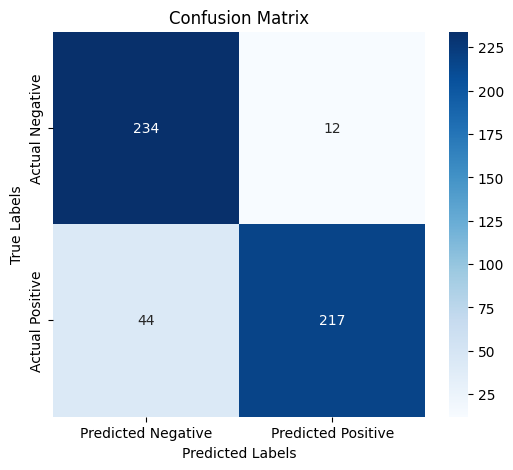

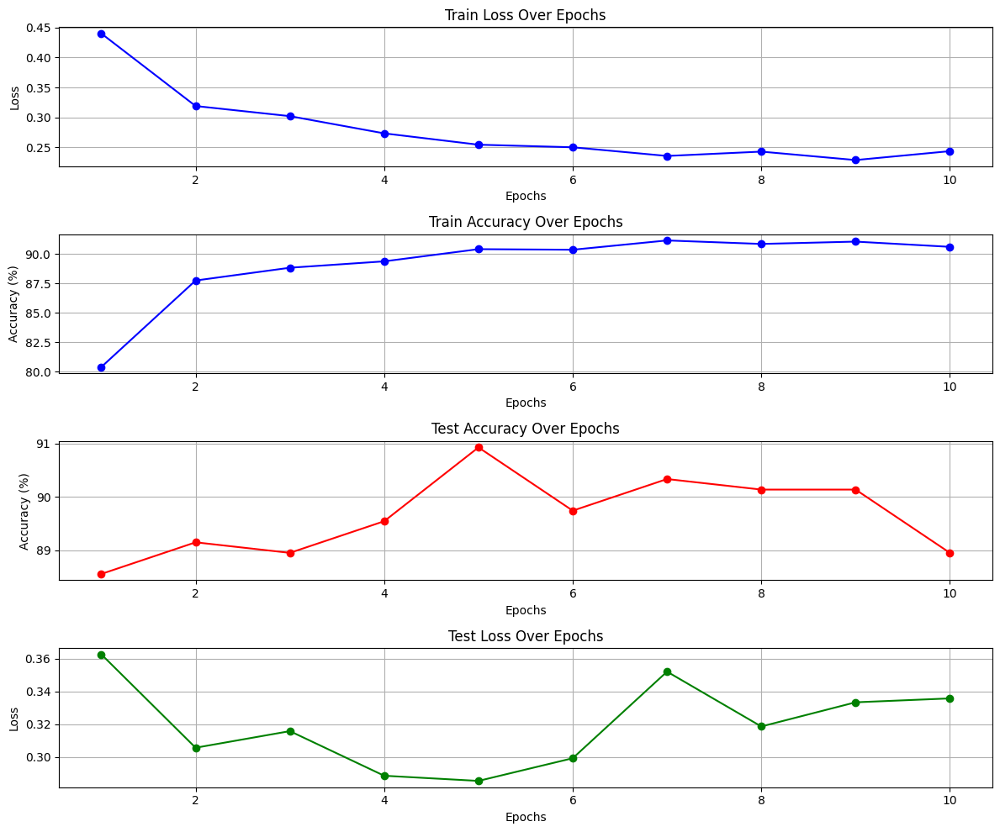

In [ ]:
# Lists to store loss and accuracy values for plotting
train_losses = []
train_accuracies = []
test_accuracies = []
test_losses = []

# Training loop
model.train()
for epoch in range(num_epochs):
    total_loss = 0
    correct = 0
    total = 0
    for batch_X, batch_y in train_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)

        optimizer.zero_grad()
        output = model(batch_X)

        loss = criterion(output, batch_y)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        # Accuracy calculation
        _, predicted = torch.max(output, 1)
        correct += (predicted == batch_y).sum().item()
        total += batch_y.size(0)

    avg_loss = total_loss / len(train_loader)
    accuracy = correct / total * 100
    train_losses.append(avg_loss)
    train_accuracies.append(accuracy)

    # Evaluate on the test set at the end of each epoch
    model.eval()
    with torch.no_grad():
        # Test accuracy
        y_pred_test = model(X_test_tensor.to(device)).argmax(dim=1).cpu()
        y_test_actual = y_test_tensor.cpu()
        test_accuracy = accuracy_score(y_test_actual, y_pred_test)
        test_accuracies.append(test_accuracy * 100)

        # Test loss
        test_output = model(X_test_tensor.to(device))
        test_loss = criterion(test_output, y_test_tensor.to(device))
        test_losses.append(test_loss.item())

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}, Train Accuracy: {accuracy:.2f}%, Test Accuracy: {test_accuracy * 100:.2f}%, Test Loss: {test_loss.item():.4f}")
print(f"Train Accuracy: {train_accuracy:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")
print("\nClassification Report on Test Data:\n", classification_report(y_test_actual, y_pred_test))

    # Confusion Matrix
cm = confusion_matrix(y_test_actual, y_pred_test)
     # Plotting the confusion matrix
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=['Predicted Negative', 'Predicted Positive'], yticklabels=['Actual Negative', 'Actual Positive'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Plotting the metrics (train accuracy, test accuracy, train loss, and test loss)
plt.figure(figsize=(12, 10))

# Plot Train Loss
plt.subplot(4, 1, 1)
plt.plot(range(1, num_epochs + 1), train_losses, label='Train Loss', color='blue', marker='o')
plt.title('Train Loss Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.grid(True)

# Plot Train Accuracy
plt.subplot(4, 1, 2)
plt.plot(range(1, num_epochs + 1), train_accuracies, label='Train Accuracy', color='blue', marker='o')
plt.title('Train Accuracy Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.grid(True)

# Plot Test Accuracy
plt.subplot(4, 1, 3)
plt.plot(range(1, num_epochs + 1), test_accuracies, label='Test Accuracy', color='red', marker='o')
plt.title('Test Accuracy Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.grid(True)

# Plot Test Loss
plt.subplot(4, 1, 4)
plt.plot(range(1, num_epochs + 1), test_losses, label='Test Loss', color='green', marker='o')
plt.title('Test Loss Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.grid(True)

# Show the plots
plt.tight_layout()
plt.show()

In [ ]:
print(model)

HybridCNNSeq2SeqTransformer(
  (cnn): Conv1d(515, 64, kernel_size=(3,), stride=(1,), padding=(1,))
  (encoder_layer): TransformerEncoderLayer(
    (self_attn): MultiheadAttention(
      (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
    )
    (linear1): Linear(in_features=64, out_features=2048, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
    (linear2): Linear(in_features=2048, out_features=64, bias=True)
    (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
    (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
    (dropout1): Dropout(p=0.1, inplace=False)
    (dropout2): Dropout(p=0.1, inplace=False)
  )
  (encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-1): 2 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=2048, 

In [ ]:
# Function to preprocess a single sample
def preprocess_single_sample(sample, vectorizer, scaler, encoder):
    # Convert sample to DataFrame
    sample_df = pd.DataFrame([sample])

    # Clean text data
    sample_df['clean_comments'] = sample_df['Comments'].apply(clean_text)
    sample_text = sample_df['clean_comments']

    # Vectorize text data
    sample_text_tfidf = vectorizer.transform(sample_text).toarray()

    # Drop unnecessary columns
    sample_structured = sample_df.drop(['Comments', 'clean_comments'], axis=1)

    # Normalize structured data
    sample_structured = scaler.transform(sample_structured)

    # Combine structured and text data
    sample_combined = np.hstack((sample_structured, sample_text_tfidf))

    return torch.tensor(sample_combined, dtype=torch.float32)

# Example single sample (similar to your dataset)
single_sample = {
    'Sex': 0,
    'Status': 1,
    'Children': 0,
    'Est_Income': 45000.00,
    'Car_Owner':0,
    'Usage': 50.00,
    'Age': 35,
    'RatePlan': '1',
    'LongDistance': 15.00,
    'International': 0.00,
    'Local': 35.00,
    'Dropped': 0,
    'Paymethod': 1,
    'LocalBilltype': 0,
    'LongDistanceBilltype': 1,
    'Comments': 'Wanted to know about new plans available.'
}

# Preprocess the single sample
preprocessed_sample = preprocess_single_sample(single_sample, vectorizer, scaler, encoder)

model.eval()
with torch.no_grad():
    # Predictions for training and testing data
    y_pred_train = model(preprocessed_sample.to(device)).argmax(dim=1).cpu()
    y_pred_classes = ['Current' if p == 1 else 'Cancelled' for p in y_pred_train]
    print('hybrid model prediction:')
    print(y_pred_classes)

hybrid model prediction:
['Cancelled']


# EXPLAINABLE BOOSTING CLASSIFIER FOR EXPLAINABILITY AND INTERPRETABILITY

# EBC FOR TOTAL DATA

In [ ]:
!pip install interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 15.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.1/44.1 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.7/14.7 MB 38.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 75.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 55.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.4/119.4 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 59.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 778.9/778.9 kB 29.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 55.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.2/254.2 kB 16.7 MB/s eta 0:00:00
  Created

In [ ]:
# Import the EBC
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show

# Initialize the Explainable Boosting Classifier
ebc_model = ExplainableBoostingClassifier(random_state=42)

# Train the model on the resampled data
ebc_model.fit(X_train, y_train)

# Predict on the test set
y_pred = ebc_model.predict(X_test)

Classification Report for Explainable Boosting Classifier:
              precision    recall  f1-score   support

           0       0.90      0.95      0.92       246
           1       0.95      0.90      0.92       261

    accuracy                           0.92       507
   macro avg       0.92      0.92      0.92       507
weighted avg       0.92      0.92      0.92       507



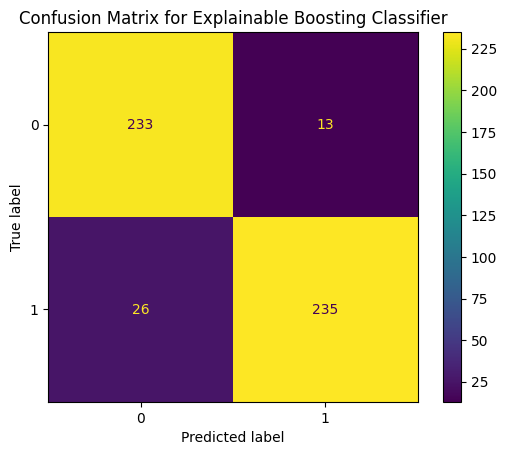

In [ ]:
# Display classification report
print("Classification Report for Explainable Boosting Classifier:")
print(classification_report(y_test, y_pred))

# Plot the confusion matrix
ConfusionMatrixDisplay.from_estimator(ebc_model, X_test, y_test)
plt.title("Confusion Matrix for Explainable Boosting Classifier")
plt.show()

In [ ]:
X_test.shape[1]

In [ ]:
# Interpretability - Get Global and Local Explanations
# Global Explanation
ebc_global_explanation = ebc_model.explain_global()
show(ebc_global_explanation)

In [ ]:
# Local Explanation for first instance
ebc_local_explanation = ebc_model.explain_local(X_test[:5], y_test[:5])
show(ebc_local_explanation)

# EBC FOR STRUCTURED DATA ALONE

In [ ]:
# Apply SMOTE to the structured data only
smote = SMOTE(random_state=42)
X_structured_resampled, y_resampled_struct = smote.fit_resample(X_structured, y)

# Now perform the train-test split on the resampled structured data
X_train_struct, X_test_struct, y_train_struct, y_test_struct = train_test_split(
    X_structured_resampled, y_resampled_struct, test_size=0.2, random_state=42
)

In [ ]:
# Initialize the Explainable Boosting Classifier
ebc_model_struct = ExplainableBoostingClassifier(random_state=42)

# Train the model on structured data only
ebc_model_struct.fit(X_train_struct, y_train_struct)

# Predict on the structured test set
y_pred_struct = ebc_model_struct.predict(X_test_struct)

In [ ]:
# Display classification report for the structured-only model
print("Classification Report for Explainable Boosting Classifier (Structured Data Only):")
print(classification_report(y_test_struct, y_pred_struct))

# Plot the confusion matrix for the structured-only model
ConfusionMatrixDisplay.from_estimator(ebc_model_struct, X_test_struct, y_test_struct)
plt.title("Confusion Matrix for Explainable Boosting Classifier (Structured Data Only)")
plt.show()

In [ ]:
# Interpretability - Get Global and Local Explanations
# Global Explanation for structured data
ebc_global_explanation_struct = ebc_model_struct.explain_global()
show(ebc_global_explanation_struct)

In [ ]:
# Local Explanation for the first few instances
ebc_local_explanation_struct = ebc_model_struct.explain_local(X_test_struct[:5], y_test_struct[:5])
show(ebc_local_explanation_struct)